In [1]:
import pandas as pd
# import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.metrics import make_scorer, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
import lightgbm as lgb
import shap
import lime
import os
# from joblib import dump
import joblib
import warnings
import statsmodels.api as sm
import numpy as np

warnings.filterwarnings('ignore')
# import dask.dataframe as dd


# Format setup

In [2]:
exps_dir = "../../exps"
if os.path.exists(exps_dir) == False: # tạo thư mục (nếu chưa có)
  os.makedirs(exps_dir, exist_ok=True)

save_dir = f"{exps_dir}/exp2"
os.makedirs(save_dir, exist_ok=True)

In [3]:
style_dir='../../styles'
plt.style.use(f'{style_dir}/style.mplstyle')
shap.initjs()

# Load Dataset

In [4]:
ndays=1
X=pd.read_csv(f'{save_dir}/X.csv', index_col=None)
y=pd.read_csv(f'{save_dir}/y.csv', index_col=None)
X_train=pd.read_csv(f'{save_dir}/X_train.csv', index_col=None)
X_valid=pd.read_csv(f'{save_dir}/X_valid.csv', index_col=None)
y_train=pd.read_csv(f'{save_dir}/y_train.csv', index_col=None)
y_valid=pd.read_csv(f'{save_dir}/y_valid.csv', index_col=None)
X_test=pd.read_csv(f'{save_dir}/X_test.csv', index_col=None)
y_test=pd.read_csv(f'{save_dir}/y_test.csv', index_col=None)

best_params = dict(np.load(f'{save_dir}/best_params_.npz',allow_pickle=True))


In [5]:
X.drop(columns=['Unnamed: 0'], inplace=True)
y.drop(columns=['Unnamed: 0'], inplace=True)
X_train.drop(columns=['Unnamed: 0'], inplace=True)
X_valid.drop(columns=['Unnamed: 0'], inplace=True)
y_train.drop(columns=['Unnamed: 0'], inplace=True)
y_valid.drop(columns=['Unnamed: 0'], inplace=True)
print(X_train.shape, y_train.shape, X_valid.shape, y_valid.shape)

(1079454, 141) (1079454, 1) (531672, 141) (531672, 1)


In [6]:
X_test.drop(columns=['Unnamed: 0'], inplace=True)
y_test.drop(columns=['Unnamed: 0'], inplace=True)

### Analyze the regression relation

#### Use OLS regression

In [10]:
def analyze_OLS(x,y):
    x = sm.add_constant(x)  
    model = sm.OLS(y, x,hasconst=True)
    results = model.fit()
    summary = results.summary()
    # print(summary)
    return summary
print(analyze_OLS(X,y))

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.881
Model:                            OLS   Adj. R-squared:                  0.881
Method:                 Least Squares   F-statistic:                 1.208e+05
Date:                Tue, 09 Jul 2024   Prob (F-statistic):               0.00
Time:                        21:10:54   Log-Likelihood:            -1.1674e+07
No. Observations:             1622156   AIC:                         2.335e+07
Df Residuals:                 1622056   BIC:                         2.335e+07
Df Model:                          99                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

#### Use Linear machine learning model

In [11]:
def print_sorted_coefficients(model, model_name, feature_names):
    coef = model.coef_
    if len(coef.shape) > 1:
        coef = coef[0]
    sorted_indices = np.argsort(-np.abs(coef))  
    sorted_coef = coef[sorted_indices]
    sorted_feature_names = [feature_names[i] for i in sorted_indices]
    for i, (name, value) in enumerate(zip(sorted_feature_names, sorted_coef)):
        print(f"{model_name} Coefficient {i + 1}: {name}, Coefficient: {value}")

In [12]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_pred_linear = linear_model.predict(X_valid)

print_sorted_coefficients(linear_model, "Linear Regression", X_train.columns)
print("Linear Regression intercept:", linear_model.intercept_)





Linear Regression Coefficient 1: data_block_id, Coefficient: 13467226.20442671
Linear Regression Coefficient 2: data_block_id_right, Coefficient: -13467226.203987883
Linear Regression Coefficient 3: hours_ahead_fl, Coefficient: -53327.16755935503
Linear Regression Coefficient 4: shortwave_radiation, Coefficient: -19693.258632192155
Linear Regression Coefficient 5: hours_ahead_fd_7d, Coefficient: -19031.49998072174
Linear Regression Coefficient 6: direct_solar_radiation_hd_7d, Coefficient: 14079.43807429145
Linear Regression Coefficient 7: hours_ahead, Coefficient: 8213.80492643267
Linear Regression Coefficient 8: diffuse_radiation, Coefficient: 6611.801684769569
Linear Regression Coefficient 9: shortwave_radiation_hl_7d, Coefficient: -5651.154009171529
Linear Regression Coefficient 10: direct_solar_radiation_hl_7d, Coefficient: 4126.929252208676
Linear Regression Coefficient 11: hours_ahead_fl_7d, Coefficient: 2931.828250642866
Linear Regression Coefficient 12: diffuse_radiation_hl_7d,

In [13]:
print("Linear Regression R²:", r2_score(y_valid, y_pred_linear))
print("Linear Regression MAE:", mean_absolute_error(y_valid, y_pred_linear))

Linear Regression R²: -254568.50621239576
Linear Regression MAE: 346.12743844785206


In [14]:
ridge_model = Ridge(alpha=1.0)
ridge_model.fit(X_train, y_train)
y_pred_ridge = ridge_model.predict(X_valid)

In [15]:

print_sorted_coefficients(ridge_model, "Ridge Regression", X_train.columns)
print("Ridge Regression intercept:", ridge_model.intercept_)


Ridge Regression Coefficient 1: installed_capacity, Coefficient: 0.11719582568575818
Ridge Regression Coefficient 2: eic_count, Coefficient: -0.052126701414449944
Ridge Regression Coefficient 3: is_consumption, Coefficient: 0.04988112051813104
Ridge Regression Coefficient 4: temperature_hd_7d, Coefficient: -0.034027368958012186
Ridge Regression Coefficient 5: dewpoint_hd_7d, Coefficient: 0.03398798102136791
Ridge Regression Coefficient 6: surface_solar_radiation_downwards_fl, Coefficient: 0.03160523524499841
Ridge Regression Coefficient 7: surface_solar_radiation_downwards_fd_7d, Coefficient: -0.02710538846444507
Ridge Regression Coefficient 8: surface_solar_radiation_downwards, Coefficient: 0.025008360693642803
Ridge Regression Coefficient 9: dewpoint_fd_7d, Coefficient: -0.02156107518681908
Ridge Regression Coefficient 10: diffuse_radiation, Coefficient: -0.020135774856148057
Ridge Regression Coefficient 11: weekday, Coefficient: -0.019714069332597017
Ridge Regression Coefficient 12:

# Setup best model and Evaluate metrics

## Setup best model

In [7]:
lgbm_model = joblib.load(f'{save_dir}/lgbm_model_tuning.joblib')
dt_model = joblib.load(f'{save_dir}/dt_model_tuning.joblib')
xgboost_model = joblib.load(f'{save_dir}/xgb_model_tuning.joblib')

## Evaluate Metrisc

In [20]:
import time
def evaluate_model(model, X_train, y_train, X_valid, y_valid, X_test, y_test):
    model_dict = {}
    
    # Train dataset
    start_time = time.time()
    y_pred_train = model.predict(X_train)
    mae_train = mean_absolute_error(y_train, y_pred_train)
    var_train = r2_score(y_train, y_pred_train)
    train_time = time.time() - start_time
    model_dict['Train'] = {'Model': model.__class__.__name__, 'MAE': mae_train, 'R2': var_train, 'Time': train_time}
    
    # Validation dataset
    start_time = time.time()
    y_pred_valid = model.predict(X_valid)
    mae_valid = mean_absolute_error(y_valid, y_pred_valid)
    var_valid = r2_score(y_valid, y_pred_valid)
    valid_time = time.time() - start_time
    model_dict['Validation'] = {'Model': model.__class__.__name__, 'MAE': mae_valid, 'R2': var_valid, 'Time': valid_time}
    
    # Test dataset
    start_time = time.time()
    y_pred_test = model.predict(X_test)
    mae_test = mean_absolute_error(y_test, y_pred_test)
    var_test = r2_score(y_test, y_pred_test)
    test_time = time.time() - start_time
    model_dict['Test'] = {'Model': model.__class__.__name__, 'MAE': mae_test, 'R2': var_test, 'Time': test_time}
    
    return model_dict

In [21]:
import json

# Evaluate models
lgbm_model_eval = evaluate_model(lgbm_model, X_train, y_train, X_valid, y_valid, X_test, y_test)
dt_model_eval = evaluate_model(dt_model, X_train, y_train, X_valid, y_valid, X_test, y_test)
xgboost_model_eval = evaluate_model(xgboost_model, X_train, y_train, X_valid, y_valid, X_test, y_test)

# Prepare results for JSON
results = {
    "lgbm": lgbm_model_eval,
    "decision_tree": dt_model_eval,
    "xgboost": xgboost_model_eval
}

In [23]:
with open(f'{save_dir}/results.json', 'w') as file:
    json.dump(results, file)

# Use SHAP to explained

In [8]:
def create_explainer(model, train_data = X_train) -> shap.Explainer:
    """
    Creates an explainer instance for a given trained model and train dataframe.

    Parameters:
    - model: The trained model instance.
    - train_data: The training dataset used to train the model.

    Returns:
    - An explainer instance for the given model and train data.
    """
    explainer = shap.Explainer(model, train_data)
    return explainer

In [9]:
# Fitting the explainer
explainers = {}
models = [lgbm_model, dt_model, xgboost_model]
for model in models: 
    explainer = create_explainer(model=model, train_data=X_train)
    explainers[model.__class__.__name__] = explainer

In [10]:
explainers

{'LGBMRegressor': <shap.explainers._tree.TreeExplainer at 0x1e6d400e110>,
 'DecisionTreeRegressor': <shap.explainers._tree.TreeExplainer at 0x1e6d5435660>,
 'XGBRegressor': <shap.explainers._tree.TreeExplainer at 0x1e6d5435b40>}

## Fitting the SHAP value

In [11]:
shap_values_test = {}
for model_name, explainer in explainers.items():
    shap_values_test[model_name] = explainer(X_test, check_additivity=False)


 97%|=================== | 5980/6144 [00:28<00:00]       

In [12]:
print(shap_values_test.keys())

dict_keys(['LGBMRegressor', 'DecisionTreeRegressor', 'XGBRegressor'])


In [14]:
import json
shap_values_test_serialized = {model_name: shap_values_test[model_name].values.tolist() for model_name in shap_values_test.keys()}
with open(f'{save_dir}/shap_values_test.json', 'w') as f:
    json.dump(shap_values_test_serialized, f)

## Interprete with LGBM

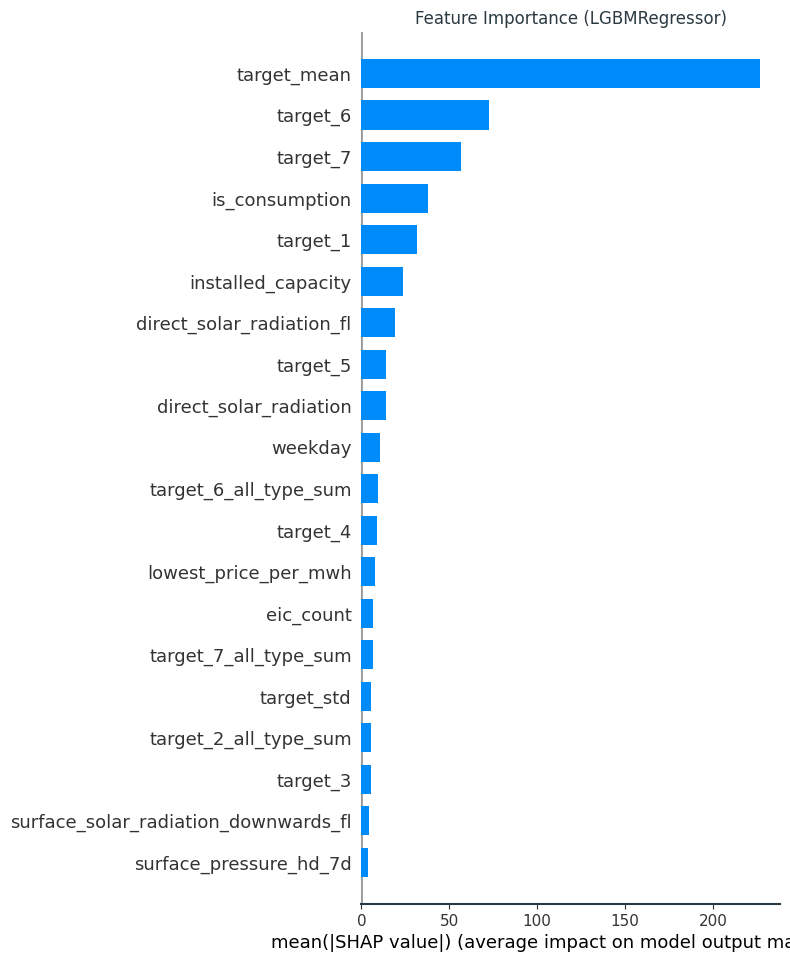

In [15]:
shap_values_lgbm = shap_values_test['LGBMRegressor']
plt.figure(figsize=(8, 4))
shap.summary_plot(shap_values_lgbm, X_test, plot_type="bar", show=False)
plt.title("Feature Importance (LGBMRegressor)", fontsize=12)
plt.show()

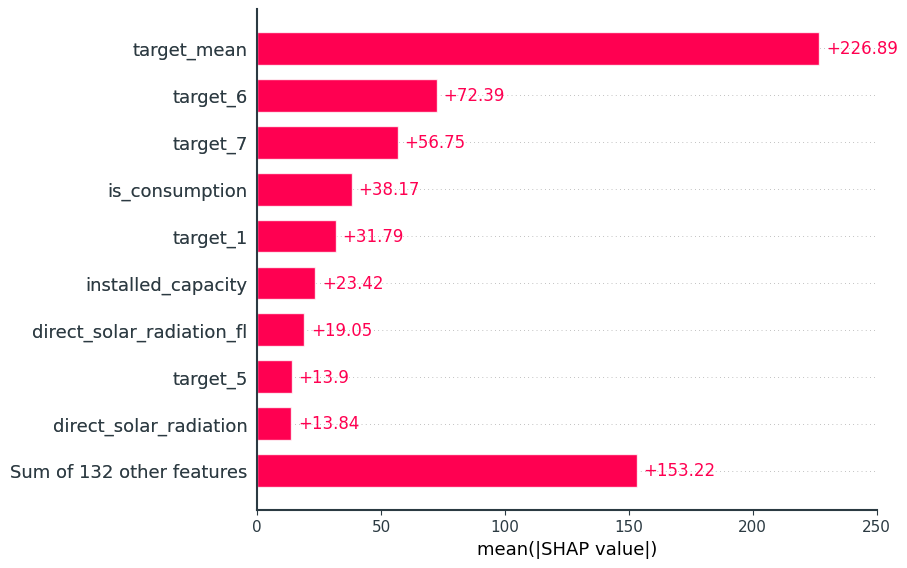

In [16]:
shap.plots.bar(shap_values_lgbm, show=False)
plt.show()
# plt.savefig("plots/bar.png")

In [17]:
lgbm_model_predictions = lgbm_model.predict(X_test)

In [18]:
i_med = np.argsort(lgbm_model_predictions)[len(lgbm_model_predictions)//2]
i_max = np.argmax(lgbm_model_predictions)
i_80 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.8)]
i_60 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.6)]
i_40 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.4)]
i_20 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.2)]
i_min = np.argmin(lgbm_model_predictions)


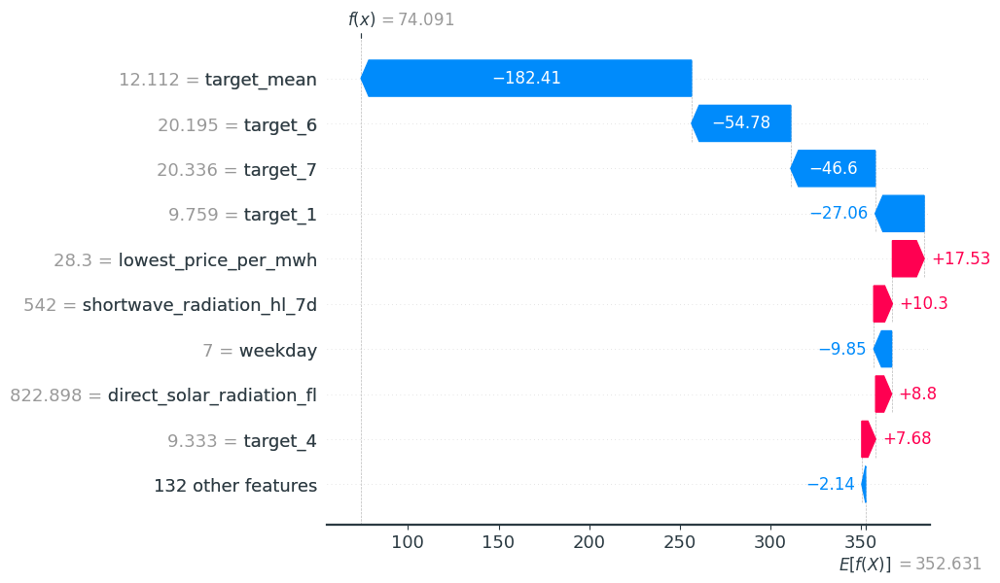

In [20]:
shap.plots.waterfall(shap_values_lgbm[i_med],show=True)
plt.show()
# plt.savefig("plots/waterfall_median.png")

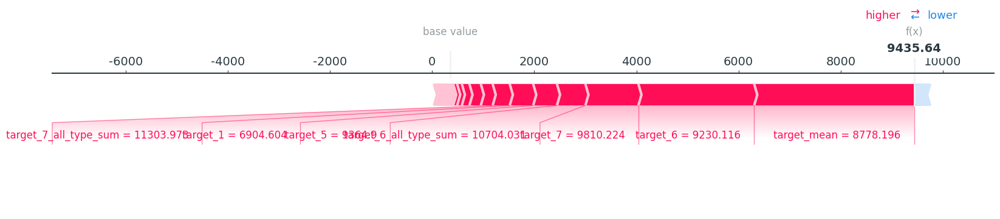

In [21]:
shap.plots.force(shap_values_lgbm[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

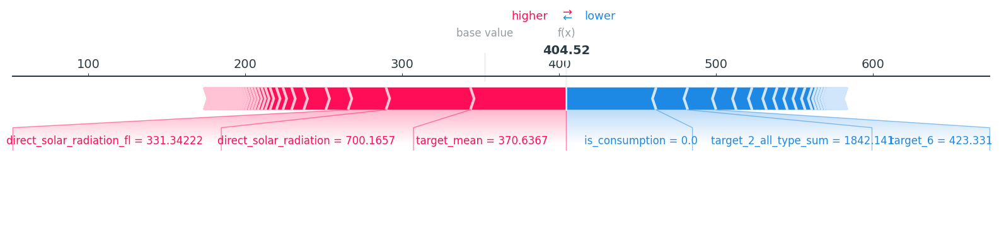

In [22]:
shap.plots.force(shap_values_lgbm[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

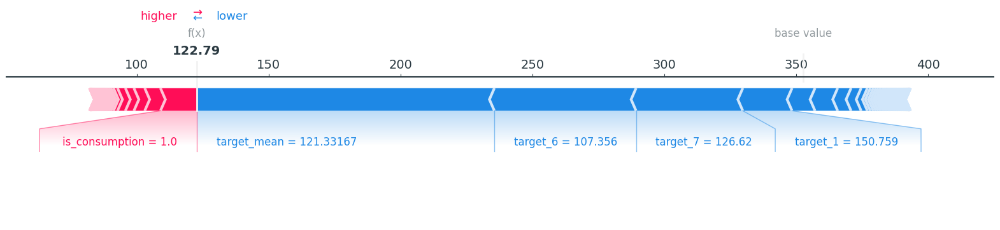

In [23]:
shap.plots.force(shap_values_lgbm[i_60], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_60.png")

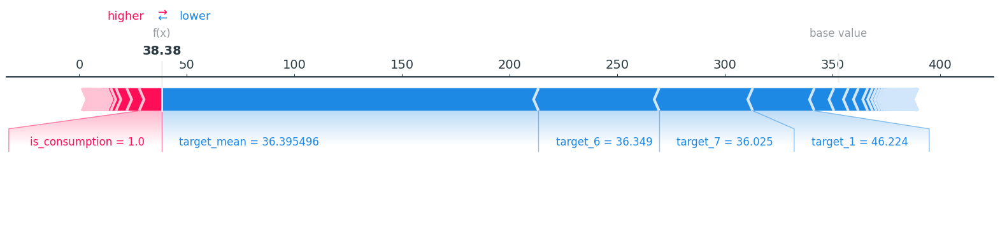

In [24]:
shap.plots.force(shap_values_lgbm[i_40], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_40.png")

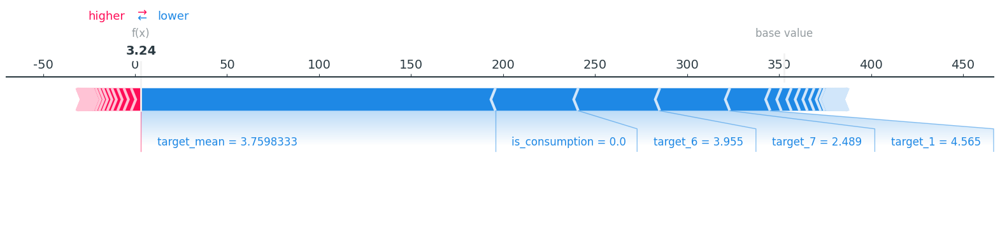

In [25]:
shap.plots.force(shap_values_lgbm[i_20], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_20.png")

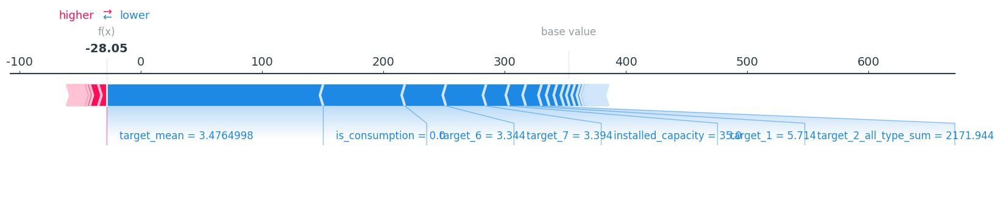

In [26]:
shap.plots.force(shap_values_lgbm[i_min], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_min.png")

## Interprete with Decision Tree

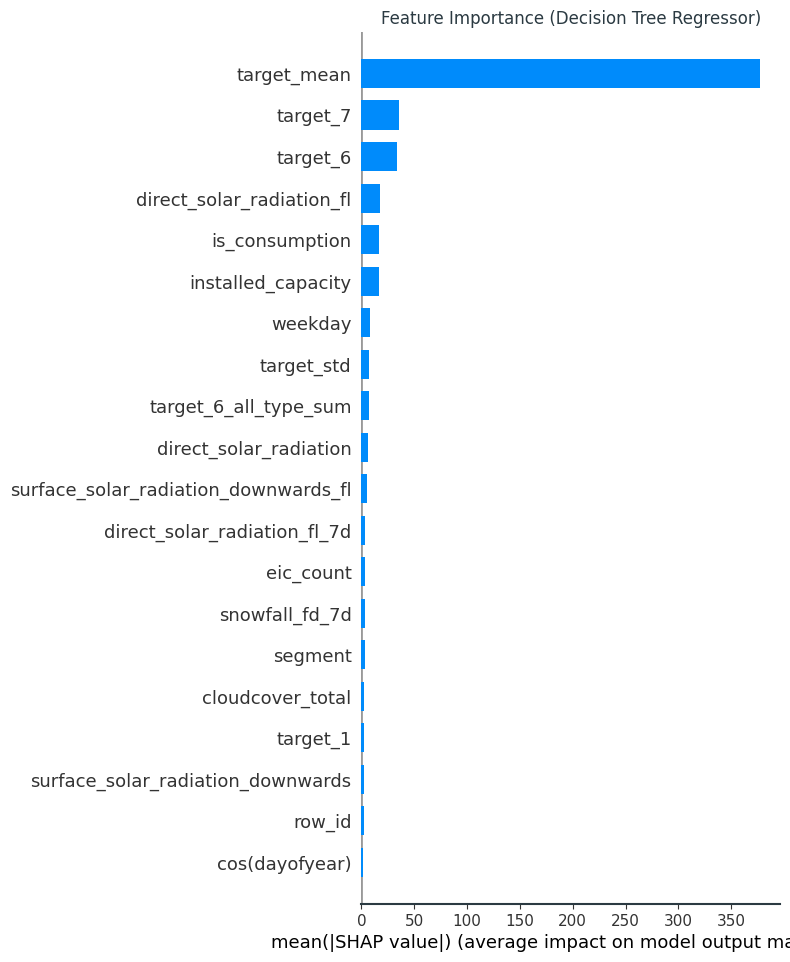

In [63]:
shap_values_dt = shap_values_test['DecisionTreeRegressor']
plt.figure(figsize=(8,4))
shap.summary_plot(shap_values_dt, X_test, plot_type='bar', show=False)
plt.title("Feature Importance (Decision Tree Regressor)", fontsize=12)
plt.show()

In [60]:
dt_model_predictions = dt_model.predict(X_test)

In [64]:
i_med = np.argsort(dt_model_predictions)[len(dt_model_predictions)//2]
i_max = np.argmax(dt_model_predictions)
i_80 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.8)]
i_60 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.6)]
i_40 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.4)]
i_20 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.2)]
i_min = np.argmin(dt_model_predictions)


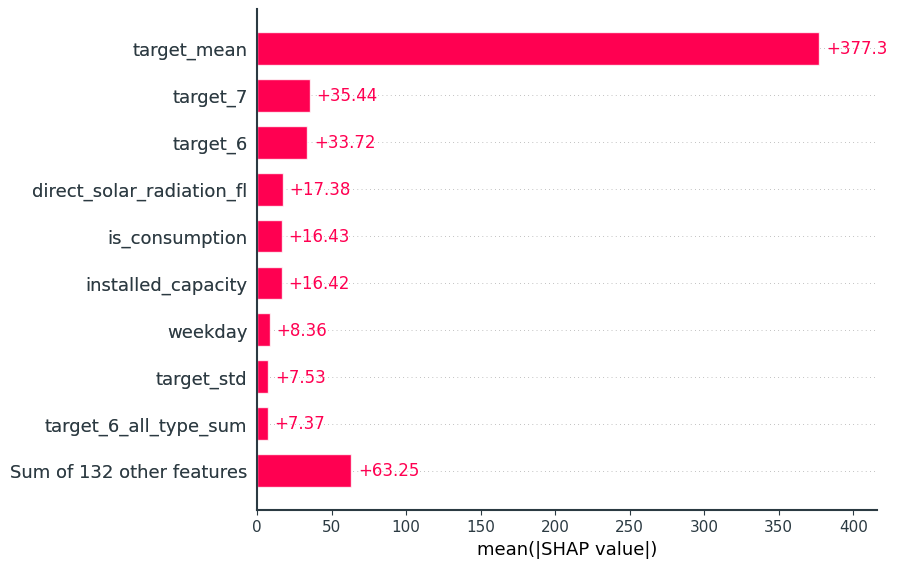

In [65]:
shap.plots.bar(shap_values_dt, show=False)
plt.show()
# plt.savefig("plots/bar.png")

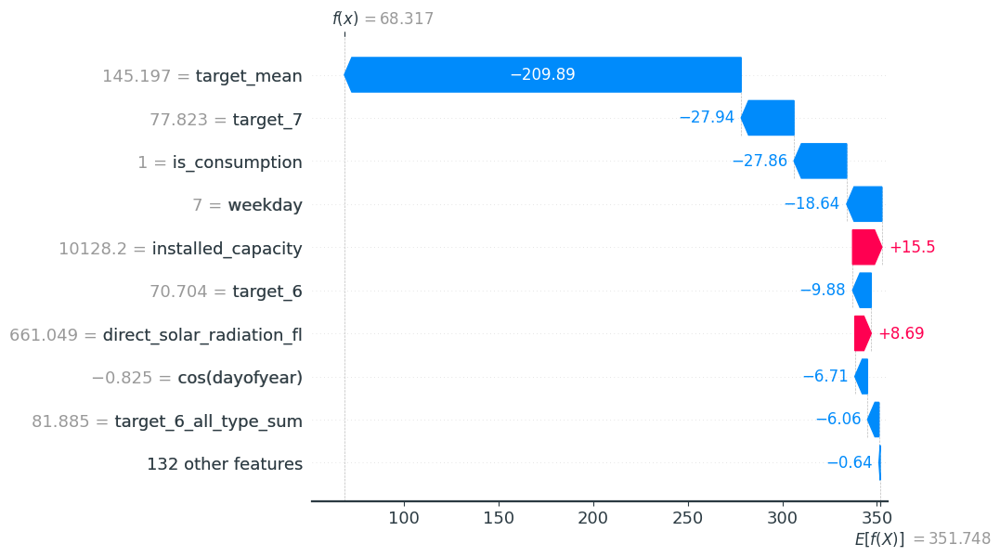

In [66]:
shap.plots.waterfall(shap_values_dt[i_med],show=True)
plt.show()
# plt.savefig("plots/waterfall_median.png")

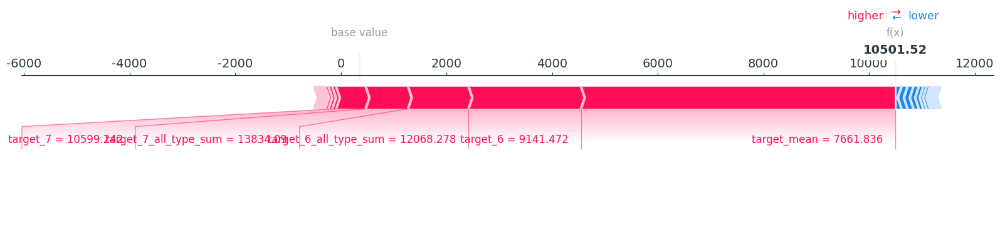

In [67]:
shap.plots.force(shap_values_dt[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

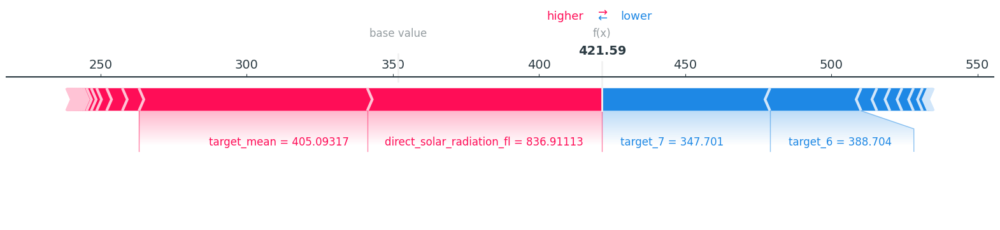

In [68]:
shap.plots.force(shap_values_dt[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

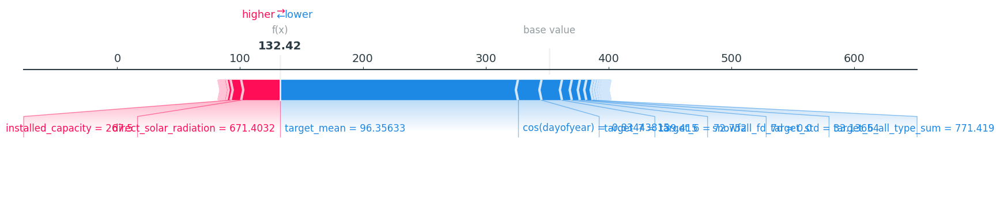

In [69]:
shap.plots.force(shap_values_dt[i_60], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_60.png")

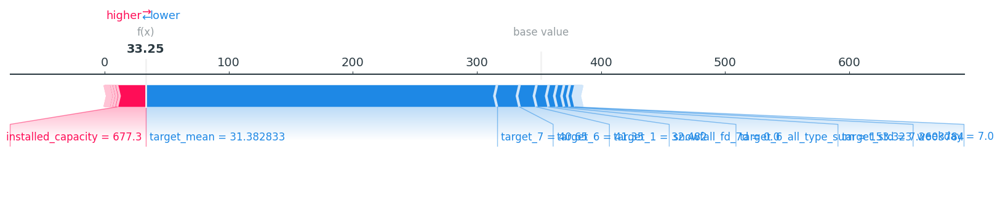

In [70]:
shap.plots.force(shap_values_dt[i_40], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_40.png")

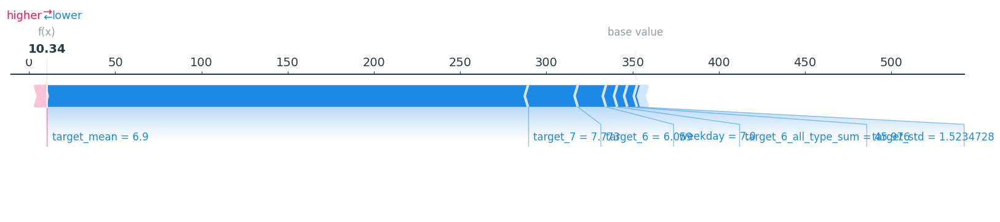

In [71]:
shap.plots.force(shap_values_dt[i_20], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_20.png")

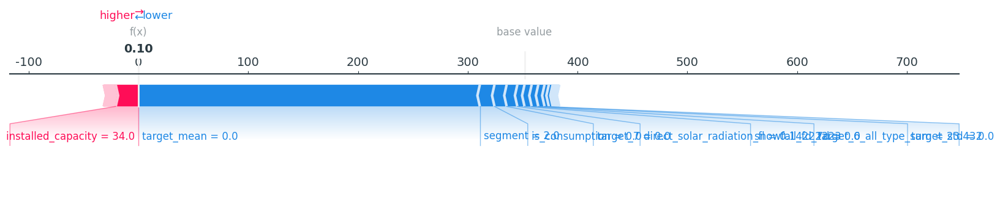

In [72]:
shap.plots.force(shap_values_dt[i_min], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_min.png")

## Interprete with XGBoost

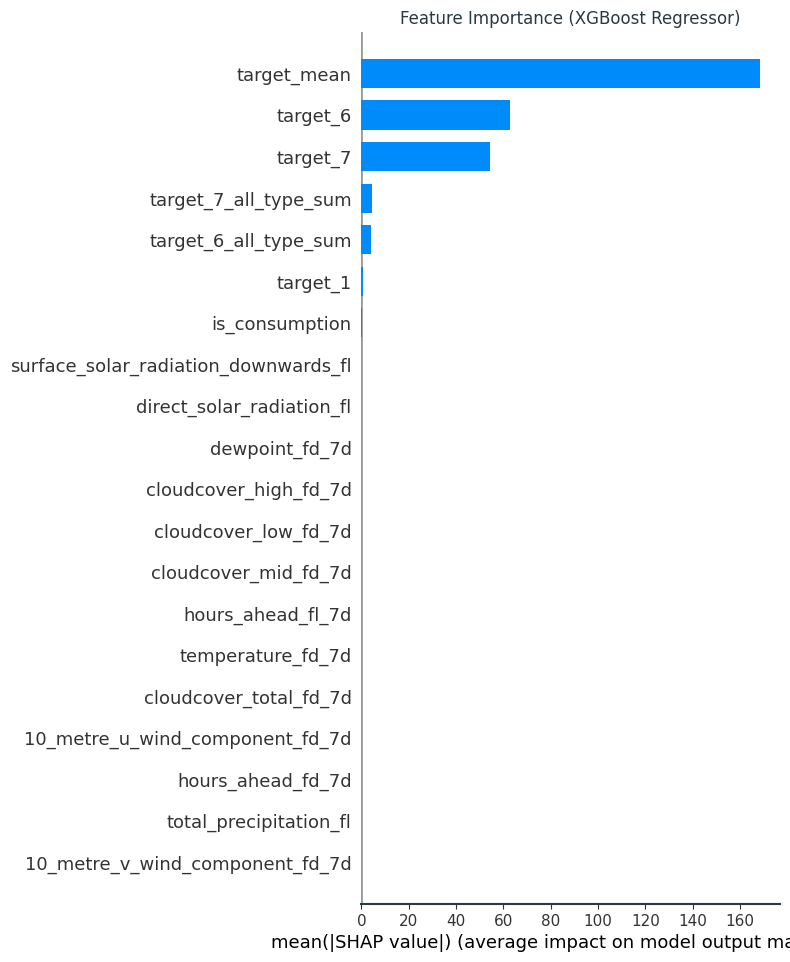

In [73]:
shap_values_xgb = shap_values_test['XGBRegressor']
plt.figure(figsize=(8,4))
shap.summary_plot(shap_values_xgb, X_test, plot_type='bar', show=False)
plt.title("Feature Importance (XGBoost Regressor)", fontsize=12)
plt.show()

In [74]:
xgboost_model_predictions = xgboost_model.predict(X_test)

In [75]:
i_med = np.argsort(xgboost_model_predictions)[len(xgboost_model_predictions)//2]
i_max = np.argmax(xgboost_model_predictions)
i_80 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.8)]
i_60 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.6)]
i_40 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.4)]
i_20 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.2)]
i_min = np.argmin(xgboost_model_predictions)


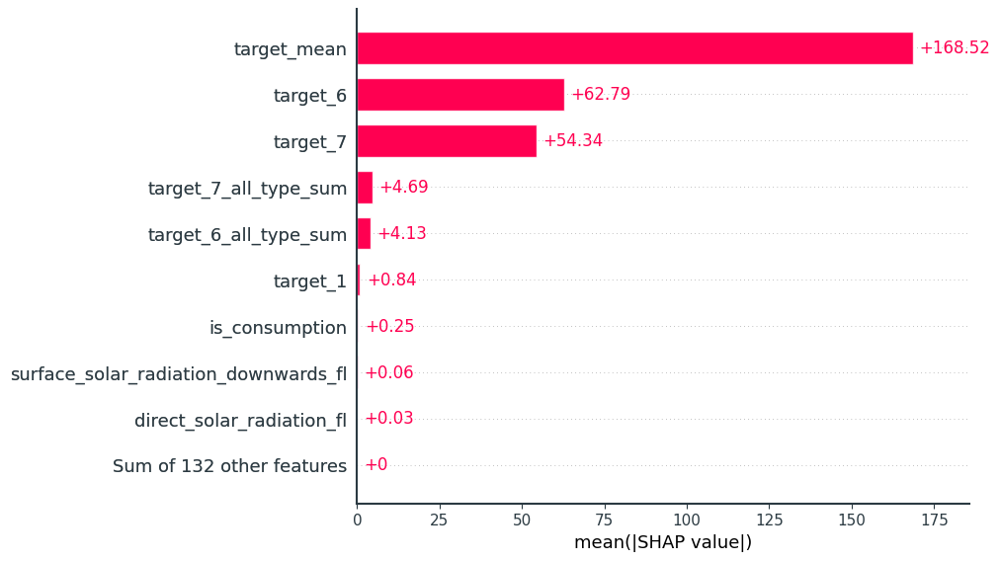

In [76]:
shap.plots.bar(shap_values_xgb, show=False)
plt.show()
# plt.savefig("plots/bar.png")

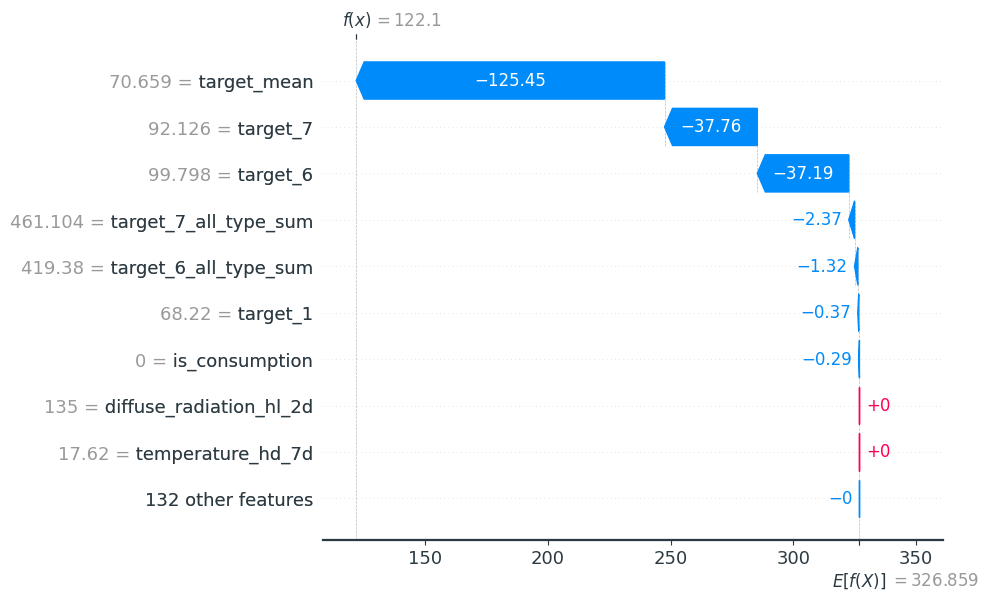

In [77]:
shap.plots.waterfall(shap_values_xgb[i_med],show=True)
plt.show()

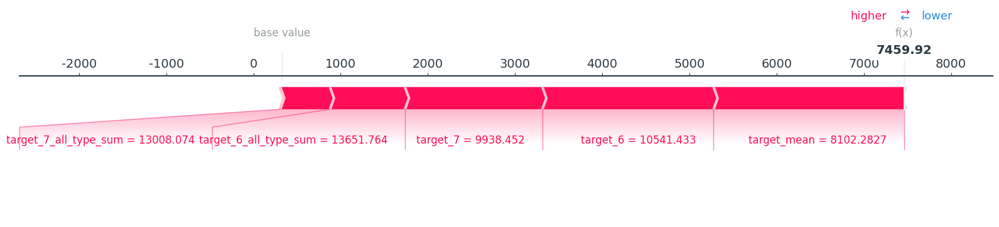

In [78]:
shap.plots.force(shap_values_xgb[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

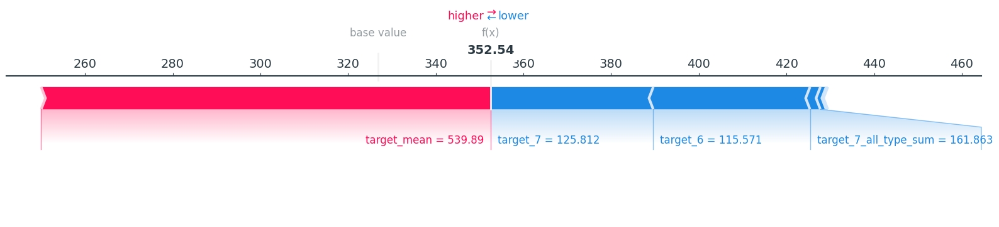

In [79]:
shap.plots.force(shap_values_xgb[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

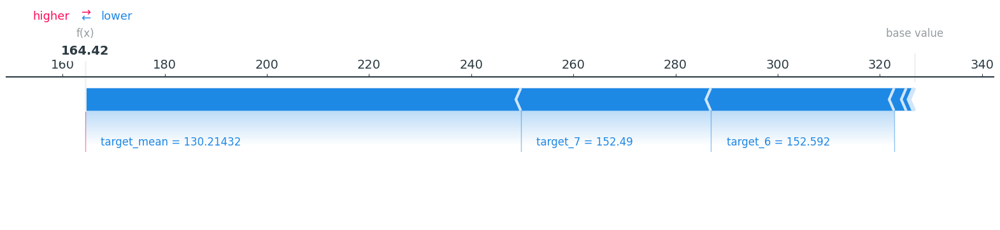

In [80]:
shap.plots.force(shap_values_xgb[i_60], show=False, matplotlib=True)
plt.show()


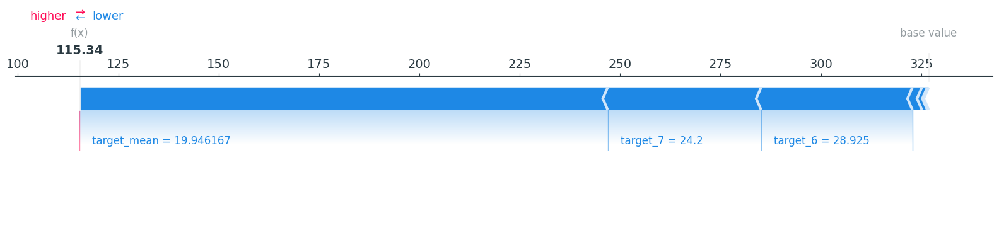

In [81]:
shap.plots.force(shap_values_xgb[i_40], show=False, matplotlib=True)
plt.show()

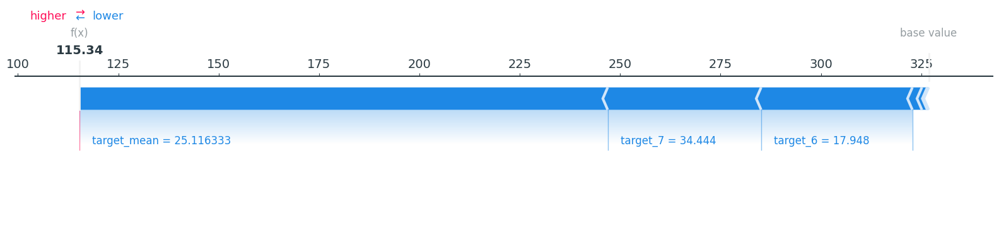

In [82]:
shap.plots.force(shap_values_xgb[i_20], show=False, matplotlib=True)
plt.show()

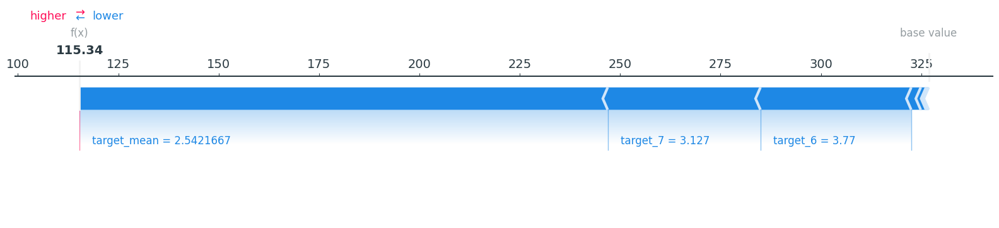

In [83]:
shap.plots.force(shap_values_xgb[i_min], show=False, matplotlib=True)
plt.show()

# Use Lime to explain

## Fitting the Lime value

In [93]:
import torch
import random
from lime.lime_tabular import LimeTabularExplainer
# Set random seeds
random_seed = 7
np.random.seed(random_seed)
random.seed(random_seed)
torch.manual_seed(random_seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


In [94]:
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    mode='regression',
    feature_names=X_train.columns,
    class_names=['target'],
    verbose=True,
    discretize_continuous=True,
    random_state = random_seed 
)


In [112]:
def display_explainers(dictionary_explainer_dict):
    for key, value in dictionary_explainer_dict.items():
        print(f"Explainer for {key}:")
        value.show_in_notebook(show_table=True)
        print(value.as_list())

## Interprete with LGBM

In [113]:
lgbm_model_predictions = lgbm_model.predict(X_test)
i_med = np.argsort(lgbm_model_predictions)[len(lgbm_model_predictions)//2]
i_max = np.argmax(lgbm_model_predictions)
i_80 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.8)]
i_60 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.6)]
i_40 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.4)]
i_20 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.2)]
i_min = np.argmin(lgbm_model_predictions)


In [104]:
def store_explanations(lime_explainer, X_test, lgbm_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max):
    explanations_dict = {}

    indices = [i_min, i_20, i_40, i_med, i_60, i_80, i_max]
    index_names = ['min', '20', '40', 'med', '60', '80', 'max']

    for i, name in zip(indices, index_names):
        exp = lime_explainer.explain_instance(X_test.values[i], lgbm_model.predict, num_features=10)
        explanations_dict[f"exp_{name}"] = exp

    return explanations_dict

lgbm_explainer_dict = store_explanations(lime_explainer, X_test, lgbm_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 527.1548914973134
Prediction_local [-22.01041219]
Right: -28.051308371787027
Intercept 527.6212766791992
Prediction_local [32.26946586]
Right: 3.2445584876633053
Intercept 391.3948232711234
Prediction_local [67.99926086]
Right: 38.37594016947155
Intercept 390.8101366001742
Prediction_local [110.44039744]
Right: 74.09099664943754
Intercept 350.9056003337855
Prediction_local [144.01016752]
Right: 122.78548642495842
Intercept 61.26971691776322
Prediction_local [848.31368791]
Right: 404.5166460204095
Intercept -14.977495685145868
Prediction_local [5393.94330797]
Right: 9435.635441919529


In [114]:
display_explainers(lgbm_explainer_dict)

Explainer for exp_min:


[('1.24 < target_mean <= 37.05', -208.88844112985186), ('0.76 < target_7 <= 32.64', -61.24111259256719), ('0.77 < target_6 <= 32.76', -61.05796708653458), ('0.94 < target_ratio <= 1.23', -47.86337582063971), ('winddirection_10m_hd_7d <= 150.19', 36.97600152879493), ('0.00 < direct_solar_radiation <= 12.57', -36.81689492497704), ('0.00 < direct_solar_radiation_fl <= 1.00', 29.388215517467255), ('0.77 < target_3 <= 32.77', 27.74387113389612), ('-1.16 < 10_metre_u_wind_component_fl <= 1.25', 24.662523415466623), ('year > 2022.00', -15.543553570353803)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -216.83784362502684), ('0.77 < target_6 <= 32.76', -76.5475923699771), ('32.64 < target_7 <= 167.03', -41.915656807877376), ('rain_hl_2d > 0.00', -35.48492507594432), ('-1.10 < 10_metre_u_wind_component_fd_7d <= 1.67', 32.50931526095012), ('-1.75 < dewpoint_hd_2d <= 4.25', 31.844989849455104), ('22.67 < cloudcover_total_hl_7d <= 63.67', 30.372385737663645), ('7.94 < temperature_hd_2d <= 13.32', -29.649920375454226), ('10_metre_v_wind_component_fl_7d <= -1.41', 28.97069531260795), ('year > 2022.00', -20.679599515309114)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -202.42510105960577), ('0.77 < target_6 <= 32.76', -68.7445615075072), ('0.76 < target_7 <= 32.64', -50.61885662726908), ('10_metre_u_wind_component_fd_7d <= -1.10', -32.971187648999994), ('snowfall_hl_2d <= 0.00', 32.203945522835575), ('cloudcover_high_hd_2d <= 5.88', 31.76079445516663), ('cos(dayofyear) <= -0.74', 29.771770425359072), ('direct_solar_radiation_hl_2d > 88.25', 29.23151783322757), ('day > 23.00', 26.56164427924542), ('snowfall_hl_7d <= 0.00', -24.432635863399558)]
Explainer for exp_med:


[('37.05 < target_mean <= 180.78', -196.92378731366256), ('32.76 < target_6 <= 168.34', -75.26087649803544), ('32.64 < target_7 <= 167.03', -56.30547569759064), ('-0.71 < cos(hour) <= -0.00', -32.17835066782451), ('year > 2022.00', 31.92747175625608), ('snowfall_hl_7d <= 0.00', 31.37955887542811), ('rain_hl_7d <= 0.00', 30.49497357419058), ('32.76 < target_5 <= 168.57', -29.70437178976595), ('-2.37 < dewpoint_fl <= 3.91', -26.895309380317475), ('10_metre_u_wind_component_fl_7d <= -1.08', -24.5665489992741)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -195.85465048760943), ('32.76 < target_6 <= 168.34', -57.76428024393543), ('32.64 < target_7 <= 167.03', -46.46610451426122), ('winddirection_10m_hl_7d <= 141.67', 46.19839883564197), ('-1.18 < 10_metre_u_wind_component <= 1.59', -32.26263766694866), ('1.25 < 10_metre_u_wind_component_fl <= 2.98', -31.773816402825766), ('winddirection_10m_hd_7d <= 150.19', 29.157519604423594), ('3.25 < windspeed_10m <= 4.37', 25.997771193983525), ('3.90 < dewpoint_hl_7d <= 9.54', 25.561679488911007), ('year > 2022.00', -15.66718778147989)]
Explainer for exp_80:


[('target_mean > 180.78', 617.793632476703), ('year > 2022.00', -193.8035298938078), ('32.76 < target_6 <= 168.34', -63.65118306983747), ('32.64 < target_7 <= 167.03', -60.32084799097616), ('rain_hl_2d <= 0.00', -28.481992326141185), ('surface_solar_radiation_downwards_fl > 213.07', -22.776746490600623), ('temperature > 13.45', 17.739737660505856), ('shortwave_radiation > 209.02', 16.662046170114465), ('direct_solar_radiation_hd_7d > 108.15', 16.088421230533548), ('31.00 < hours_ahead <= 36.00', -14.57807163598253)]
Explainer for exp_max:


[('year > 2022.00', 3148.887582015715), ('target_mean > 180.78', 627.0880475068905), ('target_6 > 168.34', 224.40466195373386), ('target_7 > 167.03', 167.83008645196708), ('0.01 < rain <= 0.05', 24.38667747856857), ('direct_solar_radiation_fl_7d > 314.82', 23.070904557724337), ('surface_solar_radiation_downwards_fl_7d > 213.31', 22.4868701933091), ('is_consumption <= 0.00', -16.480360003096216), ('0.13 < cloudcover_high_fl_7d <= 0.87', -12.653949429902289), ('diffuse_radiation_hd_7d > 90.89', -11.652307187986578)]


## Interprete with Decision Tree

In [115]:
dt_model_predictions = dt_model.predict(X_test)
i_med = np.argsort(dt_model_predictions)[len(dt_model_predictions)//2]
i_max = np.argmax(dt_model_predictions)
i_80 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.8)]
i_60 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.6)]
i_40 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.4)]
i_20 = np.argsort(dt_model_predictions)[int(len(dt_model_predictions)*0.2)]
i_min = np.argmin(dt_model_predictions)


In [116]:
dt_explainer_dict = store_explanations(lime_explainer, X_test, dt_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 443.87420528557357
Prediction_local [-36.00155301]
Right: 0.09521932311399434
Intercept 552.9771827090099
Prediction_local [7.20486897]
Right: 10.335549098920207
Intercept 529.9094493002474
Prediction_local [63.85633141]
Right: 33.245104262101705
Intercept 469.3564472504265
Prediction_local [173.06048459]
Right: 68.31701431492837
Intercept 524.6055808188041
Prediction_local [98.78766496]
Right: 132.4158895705525
Intercept 105.68489521149093
Prediction_local [833.56610977]
Right: 421.587376470588
Intercept 9.577623300870926
Prediction_local [6000.56727322]
Right: 10501.524833333335


In [117]:
display_explainers(dt_explainer_dict)


Explainer for exp_min:


[('target_mean <= 1.24', -466.1975675350722), ('0.00 < direct_solar_radiation_fl <= 1.00', -86.84447000249249), ('highest_price_per_mwh <= 104.00', -58.92401548489833), ('3.61 < target_2_all_type_sum <= 116.59', -57.95541482444756), ('-1.16 < 10_metre_u_wind_component_fl <= 1.25', 51.17469835859126), ('installed_capacity <= 325.00', 45.271849100011934), ('cloudcover_low_hd_7d <= 9.25', 44.519820083518496), ('-1.41 < 10_metre_v_wind_component_fl_7d <= 0.70', 41.61218713178384), ('total_precipitation_fl_7d <= 0.00', 39.430474997249824), ('0.00 < direct_solar_radiation <= 12.57', -31.963320119879878)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -436.63864845130365), ('rain_hd_7d <= 0.00', -62.50436745302809), ('direct_solar_radiation_fl_7d > 314.82', -60.64984397695125), ('0.17 < cloudcover_mid_hl_2d <= 20.00', 60.14397700271561), ('direct_solar_radiation > 347.99', 56.69321802406177), ('snowfall_hl_2d <= 0.00', -55.714849532715355), ('cloudcover_low_fl <= 0.00', -50.98560013153498), ('direct_solar_radiation_fl > 313.83', 47.99016174920658), ('snowfall_fd_7d <= 0.00', -47.2370410993431), ('year > 2022.00', 3.130680129401595)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -462.3409250574625), ('637.55 < installed_capacity <= 1537.70', -89.36278215491886), ('snowfall_hl_7d <= 0.00', -59.447713566202744), ('4.26 < dewpoint_hd_7d <= 9.64', 58.62128616010099), ('6.96 < cloudcover_mid_hd_2d <= 27.16', -58.01686952386812), ('windspeed_10m_hd_7d <= 3.26', 53.69121708230001), ('winddirection_10m_hd_7d <= 150.19', 50.549370796555024), ('snowfall_fd_7d <= 0.00', -50.49341871132475), ('0.77 < target_2 <= 32.78', 49.4598609634884), ('rain_hl_7d <= 0.00', 41.286856122390446)]
Explainer for exp_med:


[('37.05 < target_mean <= 180.78', -351.96527777364554), ('year > 2022.00', -104.74347027706386), ('snowfall_hl_2d <= 0.00', -83.83294511957703), ('cloudcover_total <= 0.36', 64.93447518537656), ('total_precipitation_fd_7d <= 0.00', 52.373272693115744), ('direct_solar_radiation_fl_7d > 314.82', -49.400769075969556), ('direct_solar_radiation_hl_7d > 88.33', 48.33335935840873), ('32.77 < target_4 <= 168.80', 43.090600483359324), ('shortwave_radiation_hl_2d > 198.00', 42.912810712561935), ('-1.16 < 10_metre_u_wind_component_fl <= 1.25', 42.00198115499888)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -373.965754334932), ('installed_capacity <= 325.00', 91.99772977418361), ('snowfall_fd_7d <= 0.00', -72.56698246242769), ('31.00 < hours_ahead_fl_7d <= 36.00', -59.164357205287644), ('winddirection_10m_hl_7d <= 141.67', 55.36285401929044), ('total_precipitation_fl > 0.00', -54.366958620544075), ('cloudcover_high_hd_2d <= 5.88', -49.372698431936875), ('direct_solar_radiation_hd_2d > 108.06', 45.13265348520826), ('0.45 < target_ratio <= 0.94', -42.50262668958035), ('year > 2022.00', 33.6282246088875)]
Explainer for exp_80:


[('target_mean > 180.78', 1246.8935107145903), ('year > 2022.00', -411.9787333036776), ('is_consumption <= 0.00', -64.6534036597654), ('target_7 > 167.03', 56.092607176870985), ('637.55 < installed_capacity <= 1537.70', -49.460433068591854), ('0.06 < cloudcover_low_fd_7d <= 0.24', -43.83982176585107), ('snowfall_fd_7d <= 0.00', -43.719333287745414), ('target_6 > 168.34', 43.61269087550627), ('shortwave_radiation > 209.02', -38.10843224533195), ('target_1 > 169.34', 33.042563126774034)]
Explainer for exp_max:


[('year > 2022.00', 4500.957560109498), ('target_mean > 180.78', 1280.7312953705448), ('target_7 > 167.03', 63.37082384977559), ('windspeed_10m_hl_7d <= 2.64', 45.64702552641483), ('0.00 < cloudcover_high_hl_2d <= 12.67', 45.03020554130185), ('temperature_hd_2d > 13.32', 41.93977189097705), ('winddirection_10m_hl_7d > 252.50', 39.34977589419997), ('snowfall_fd_7d <= 0.00', -39.18275497434267), ('cloudcover_mid_hl_7d <= 0.00', 38.69421232444636), ('3.00 < cloudcover_low_hl_2d <= 32.00', -25.548265609863133)]


## Interprete with XGBoost

In [118]:
xgboost_model_predictions = xgboost_model.predict(X_test)
i_med = np.argsort(xgboost_model_predictions)[len(xgboost_model_predictions)//2]
i_max = np.argmax(xgboost_model_predictions)
i_80 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.8)]
i_60 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.6)]
i_40 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.4)]
i_20 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.2)]
i_min = np.argmin(xgboost_model_predictions)


In [120]:
xgboost_explainer_dict = store_explanations(lime_explainer, X_test, xgboost_model, i_min, i_20, i_40, i_60, i_80, i_med, i_max)

Intercept 458.34685570288167
Prediction_local [65.71692981]
Right: 115.341805
Intercept 457.8284402944618
Prediction_local [116.95490049]
Right: 115.341805
Intercept 415.59801933591604
Prediction_local [133.40569991]
Right: 115.341805
Intercept 473.0589501828864
Prediction_local [125.3476274]
Right: 122.100006
Intercept 452.7526651603949
Prediction_local [137.72326733]
Right: 164.41515
Intercept 290.72500355882846
Prediction_local [540.88891609]
Right: 352.54465
Intercept 97.18629648971643
Prediction_local [4330.09915182]
Right: 7459.9175


In [121]:
display_explainers(xgboost_explainer_dict)

Explainer for exp_min:


[('1.24 < target_mean <= 37.05', -219.7642829627974), ('0.77 < target_6 <= 32.76', -76.6492353648204), ('0.76 < target_7 <= 32.64', -67.18528849575686), ('year > 2022.00', 49.624874694734096), ('0.00 < direct_solar_radiation_fl <= 1.00', -44.02455949098748), ('cloudcover_total_hd_7d <= 27.92', -34.399779897016124), ('snowfall_fl <= 0.00', 30.898963815290823), ('cloudcover_low_hd_7d <= 9.25', -30.321633332285447), ('installed_capacity > 1537.70', -26.63842101406475), ('shortwave_radiation_hl_7d <= 0.00', 25.829436154483055)]
Explainer for exp_20:


[('1.24 < target_mean <= 37.05', -222.65881485428213), ('0.77 < target_6 <= 32.76', -74.7439870387092), ('32.64 < target_7 <= 167.03', -40.132883030172636), ('cloudcover_total_fl > 1.00', -27.919181431396584), ('20.00 < cloudcover_mid_hl_2d <= 64.50', 27.6460153099669), ('7.94 < temperature_hd_2d <= 13.32', 27.569220527763225), ('7.23 < direct_solar_radiation_hd_2d <= 108.06', -25.09973156961693), ('surface_pressure > 1015.96', -25.05771507922243), ('-1.58 < 10_metre_v_wind_component <= 0.82', 21.13663334018188), ('year > 2022.00', -1.6130959822893958)]
Explainer for exp_40:


[('1.24 < target_mean <= 37.05', -216.78497997213788), ('0.77 < target_6 <= 32.76', -67.79028846507994), ('0.76 < target_7 <= 32.64', -48.723648708113956), ('10_metre_v_wind_component_fl_7d <= -1.41', 37.19351980044795), ('diffuse_radiation_hl_2d > 89.50', 32.86866024548419), ('0.25 < cloudcover_total_fl_7d <= 0.85', -31.2108995295279), ('0.77 < target_2 <= 32.78', 30.516069285082374), ('windspeed_10m_hd_7d <= 3.26', -27.94687933279103), ('snowfall_hl_2d <= 0.00', 27.750022662653222), ('year > 2022.00', -18.063895408768985)]
Explainer for exp_med:


[('37.05 < target_mean <= 180.78', -194.55178311481197), ('32.64 < target_7 <= 167.03', -46.5911848802135), ('32.76 < target_6 <= 168.34', -40.68928773000229), ('direct_solar_radiation_hd_2d > 108.06', -34.151017965392626), ('direct_solar_radiation > 347.99', -33.416046816146995), ('32.78 < target_2 <= 169.18', 26.28571254344057), ('cloudcover_low_fl_7d <= 0.00', 25.992885943909034), ('snowfall_hl_2d <= 0.00', -24.611475159849086), ('0.25 < cloudcover_total_fl_7d <= 0.85', -22.73150430441528), ('year > 2022.00', -3.247621297943914)]
Explainer for exp_60:


[('37.05 < target_mean <= 180.78', -209.62320517052154), ('32.76 < target_6 <= 168.34', -73.88351861576655), ('32.64 < target_7 <= 167.03', -43.80612262538225), ('115.20 < target_7_all_type_sum <= 730.63', -31.550580798787003), ('weekday > 6.00', -29.959717083127366), ('year > 2022.00', 26.69187854097135), ('0.00 < cloudcover_high_fl <= 0.13', 25.374730049208967), ('cloudcover_low_hl_2d <= 3.00', -24.50974416754435), ('shortwave_radiation_hl_7d <= 0.00', 23.445509763768943), ('direct_solar_radiation_fd_7d <= 0.00', 22.791372279837415)]
Explainer for exp_80:


[('target_mean > 180.78', 655.3767942404776), ('year > 2022.00', -188.34426887568353), ('32.76 < target_6 <= 168.34', -69.79191209873028), ('32.64 < target_7 <= 167.03', -50.675941546058326), ('snowfall_hl_7d <= 0.00', -33.14479546990396), ('target_1 > 169.34', 26.10640806867308), ('direct_solar_radiation > 347.99', -24.82606630347552), ('target_4 > 168.80', -23.751619861288308), ('cloudcover_total_hl_7d <= 22.67', -20.777307629716763), ('highest_price_per_mwh <= 104.00', -20.007377990642684)]
Explainer for exp_max:


[('year > 2022.00', 3129.818328646567), ('target_mean > 180.78', 675.008530424915), ('target_6 > 168.34', 211.04769643012767), ('target_7 > 167.03', 159.58971326507546), ('10_metre_v_wind_component_fl_7d <= -1.41', 22.381950871238132), ('row_id > 1195771.75', 22.17723984147847), ('temperature_fl > 13.57', 21.251288306395665), ('snowfall_hl_2d <= 0.00', 17.80624853351035), ('surface_pressure_hd_7d > 1015.84', -13.354947483562515), ('rain_hl_2d <= 0.00', -12.813193503256544)]
